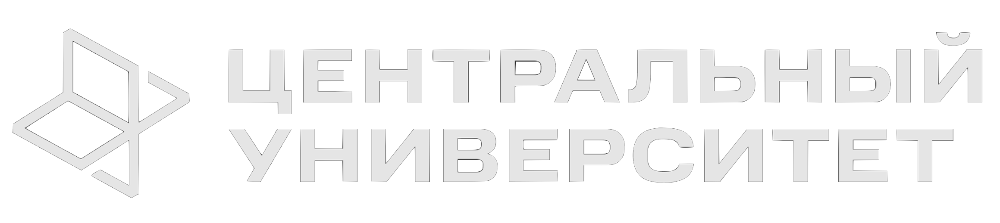

# Курс по Машинному обучению

## Семинар 1. Работа с табличными данными с помощью Pandas и Plotly

## О семинаре



Семинар, посвящен работе с табличными данными. Можно было начинать с анализа изображений, звуковых рядов или текста. Но как правило, в машинном обучении все сводится к одной таблице, в которой каждый объект описывается рядом признаков. Поэтому навык работы с таблицами важен.

В этом семинаре:
- познакомимся с постановкой задач машинного обучения
- повторим основные термины ML, которые были на Лекции 1
- познакомимся с библиотекой `pandas` - основным инструментом для работы с данными
- познакомимся с библиотекой `pyplot` - основным инструментом для визуализации данных

---------------------------------------------------------------------

## Примеры и Антипримеры задач машинного обучения

**Машинное обучение** — процесс, в результате которого машина способна показывать
поведение, которое в нее не было явно запрограммировано.

Рассмотрим пример реального продукта - интернет-сервиса для размещения объявлений о товарах, недвижимости, вакансиях и резюме на рынке труда, а также услугах и др.

**<font color='orange'>(?) Вопрос:</font>** Как вы думате, какая часть реализована с помощью ML? А какая нет? Почему?

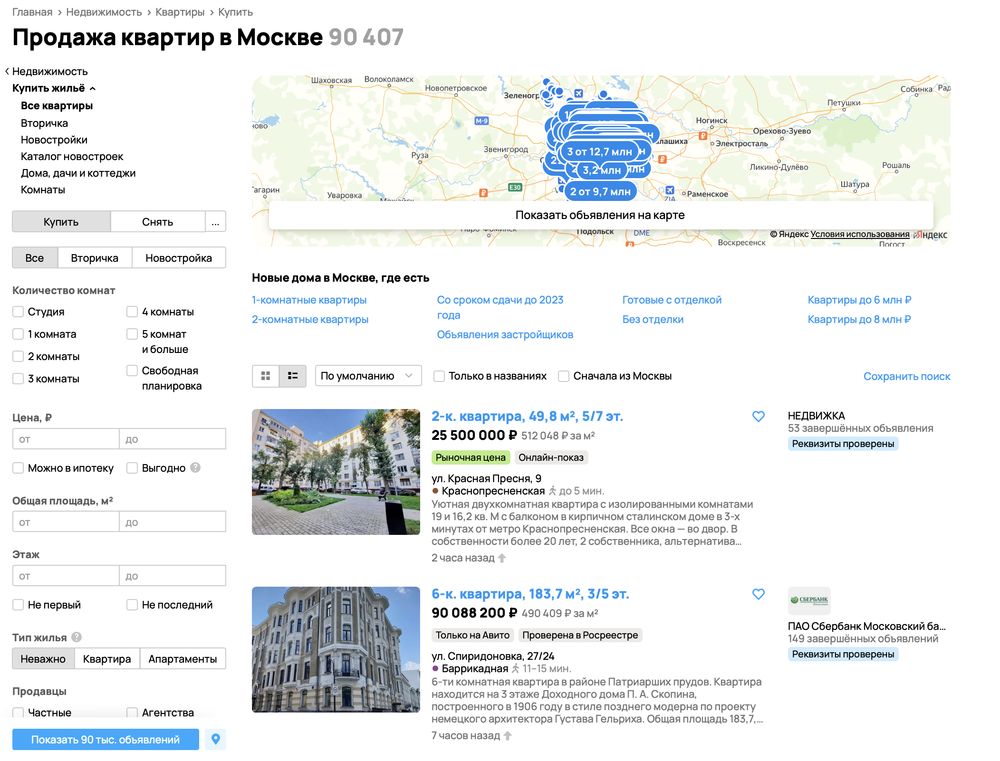

[Источник скриншота](https://www.avito.ru/)




Напомню, что общая схема проверки алгоритма следующая:

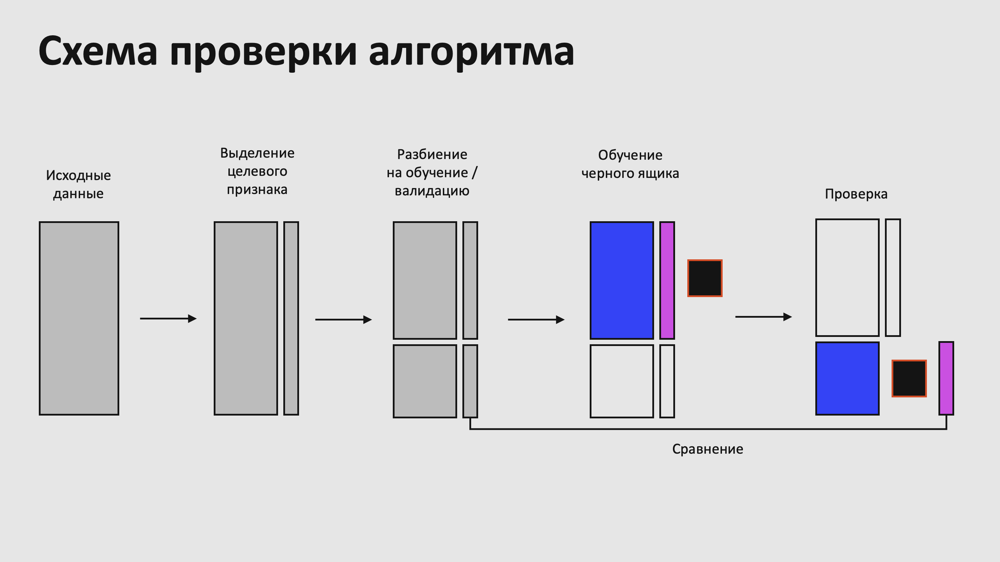

**<font color='orange'>(?) Вопрос:</font>** Что в разрезе задач, которые обсудили, будет обучающей выборкой / валидационной? Где их взять?

**<font color='orange'>(?) Вопрос:</font>** Какой это тип задачи? Какие типы бывают еще?

## Введение

Сейчас мы находимся в colab-ноутбуке (или ipython-ноутбуке). Это удобная среда для написания кода, проведения экспериментов, изучения данных, построения визуализаций и других нужд, не связанных с написанием production-кода.

**Google Colab (Colaboratory)** - это **Jupyter Notebook** + **Cloud** + **Google Drive**.

Ноутбук состоит из ячеек, каждая из которых может быть либо ячейкой с кодом, либо ячейкой с текстом размеченным и неразмеченным. Текст поддерживает markdown-разметку и формулы в Latex.

In [1]:
# ячейка с кодом, при выполнении которой появится output
1 + 1

2

Подробнее об используемом языке разметки Markdown [тут](https://athena.brynmawr.edu/jupyter/hub/dblank/public/Jupyter%20Notebook%20Users%20Manual.ipynb).

## О Pandas

**Pandas** — удобная библиотека для работы с табличными данными в Python.

С помощью **pandas** можно:
- считывать табличные данные (в форматах csv, json, xlsx)
- представлять собственные данные в виде таблиц и сохранять их
- считать статистики
- визулизировать данные
- производить обработку данных
- и другое

Основные объекты в **pandas**:

* **Series** (серия) — одномерная структура данных, в которой каждый элемент имеет свой индекс.
* **DataFrame** (датафрейм) - табличная структура данных, представляющая собой таблицу с именованными колонками различных типов и индексами строк.


Полезные материалы:
1. [Документация](http://pandas.pydata.org/pandas-docs/stable/index.html)
2. [Pandas за 10 минут из официального руководства](http://pandas.pydata.org/pandas-docs/stable/10min.html)
3. [Примеры использования функционала](http://nbviewer.jupyter.org/github/justmarkham/pandas-videos/blob/master/pandas.ipynb)

Подключаем саму библиотеку `pandas`.

Чаще всего название библиотеки при импорте сокращают до `pd`:

In [2]:
import pandas as pd

Сразу сделаем настройку, чтобы все числа в таблице округлялись до второго знака после запятой:

In [3]:
pd.set_option('display.float_format', '{:.2f}'.format)

## 1. Загрузка данных

Мы будем работать с данными из [датасета](https://www.kaggle.com/datasets/mrdaniilak/russia-real-estate-20182021), в котором содержится информация об объектах недвижимости в России с их стоимостью за 2018-2021 гг.:


*   Цена - Цена в рублях РФ (*числовое*)
*   Дата - дата публикации объявления (*временное*)
*   Время — время публикаци объявления (*временное*)
*   Коорданата x - значение координаты (широта) (*числовое*)
*   Коорданата y - значение координаты (долгота) (*числовое*)
*   Номер - код региона РФ (*категориальное*)
*   Тип здания — тип сооружения, в котором находится квартира (*категориальное*)
*   Этаж — номер этажа, на котором находится квартира (*категориальное* или *числовое*?)
*   Число этажей в доме — общее количество этажей в здании (*категориальное* или *числовое*?)
*   Комнаты — количество комнат в квартире, -1 означает студии с открытой планировкой (*категориальное* или *числовое*?)
*   Площадь - общая площадь квартиры в кв. метрах (*числовое*)
*   Площадь кухни — площадь кухни в кв. метрах (*числовое*)
*   Тип квартиры - тип квартиры, где 1 означает вторичный рынок недвижимости, 11 - новостройка (*категориальное*)



Загрузим данные с Google Drive:

Прямая ссылка для скачивания, если хотите что-то поделать с данными на своем компьютере: https://drive.google.com/file/d/13wGEWvhO4iurSN8Rddap4AHo1pAAljMl/view?usp=sharing

Переходим к загрузке самого файла:

In [4]:
 # Прописываем путь к папке с файлом
path = 'content/rus_real_estate.csv'

# Загружаем файл
data = pd.read_csv(path) # Дополнительные настройки sep=';', decimal='.', encoding='cp1251' и др.
# Также можно считывать и другие форматы файлов, например excel: pd.read_excel

Посмотрим на исходные данные и посмотрим, что в них содержится.

In [5]:
data

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type
0,6050000,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,82.60,10.80,1
1,8650000,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,69.10,12.00,1
2,4000000,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,66.00,10.00,1
3,1850000,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,38.00,5.00,11
4,5450000,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,60.00,10.00,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5477001,19739760,2021-05-01,20:13:58,55.80,37.75,3,1,8,17,4,93.20,13.80,11
5477002,12503160,2021-05-01,20:14:01,55.84,37.49,3,2,17,32,2,45.90,6.60,11
5477003,8800000,2021-05-01,20:14:04,56.28,44.08,2871,2,4,17,3,86.50,11.80,1
5477004,11831910,2021-05-01,20:14:12,55.80,37.75,3,1,8,33,2,52.10,18.90,11


Если нужно отобразить большее число строк таблицы, то можно сделать так:



```
# pd.options.display.max_rows = 999
# pd.options.display.max_rows = 20
```



Загруженные данные хранятся в переменной data, которая имеет тип [DataFrame](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.DataFrame.html):

In [6]:
type(data)

pandas.core.frame.DataFrame

DataFrame можно создать и вручную:

In [7]:
example = pd.DataFrame({
    'Столбец 1': [1, 2, 3, 4, 5],
    'Столбец 2': [10, 20, 30, 40, 50],
    'Столбец 3': ['a', 'b', 'a', '-', 0]
})
example

,Столбец 1,Столбец 2,Столбец 3
0,1,10,a
1,2,20,b
2,3,30,a
3,4,40,-
4,5,50,0


Посмотрим на часть данных:

In [8]:
data.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type
0,6050000,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,82.60,10.80,1
1,8650000,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,69.10,12.00,1
2,4000000,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,66.00,10.00,1
3,1850000,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,38.00,5.00,11
4,5450000,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,60.00,10.00,1


In [9]:
data.tail()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type
5477001,19739760,2021-05-01,20:13:58,55.80,37.75,3,1,8,17,4,93.20,13.80,11
5477002,12503160,2021-05-01,20:14:01,55.84,37.49,3,2,17,32,2,45.90,6.60,11
5477003,8800000,2021-05-01,20:14:04,56.28,44.08,2871,2,4,17,3,86.50,11.80,1
5477004,11831910,2021-05-01,20:14:12,55.80,37.75,3,1,8,33,2,52.10,18.90,11
5477005,13316200,2021-05-01,20:14:15,55.86,37.54,3,2,10,23,2,55.60,20.80,11


In [10]:
data.sample(5)

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type
4199833,5242000,2020-08-01,11:51:00,45.18,39.12,2843,3,11,20,3,97.00,14.00,11
1541186,1630000,2019-04-04,13:52:07,43.67,39.65,2843,1,2,5,1,15.00,3.00,1
4297985,5000000,2020-08-31,13:43:42,55.52,37.60,81,1,7,25,1,35.00,8.00,1
1535974,2300000,2019-04-03,21:38:16,55.09,38.76,81,3,3,4,2,41.40,5.90,1
3303699,3350000,2020-02-19,06:47:04,45.01,39.07,2843,1,4,5,4,60.00,8.00,1


Посмотрим размер таблицы:

In [11]:
data.shape

(5477006, 13)

DataFrame - это двумерная таблица, которую достаточно просто обрабатывать, используя набор готовых методов. Рассмотрим некоторые из них.

`columns` — возвращает названия колонок

`dtypes` — типы колонок

In [12]:
data.columns

Index(['price', 'date', 'time', 'geo_lat', 'geo_lon', 'region',
       'building_type', 'level', 'levels', 'rooms', 'area', 'kitchen_area',
       'object_type'],
      dtype='object')

In [13]:
data.dtypes

price              int64
date              object
time              object
geo_lat          float64
geo_lon          float64
region             int64
building_type      int64
level              int64
levels             int64
rooms              int64
area             float64
kitchen_area     float64
object_type        int64
dtype: object

Можно посмотреть одновременно:

In [14]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5477006 entries, 0 to 5477005
Data columns (total 13 columns):
 #   Column         Dtype  
---  ------         -----  
 0   price          int64  
 1   date           object 
 2   time           object 
 3   geo_lat        float64
 4   geo_lon        float64
 5   region         int64  
 6   building_type  int64  
 7   level          int64  
 8   levels         int64  
 9   rooms          int64  
 10  area           float64
 11  kitchen_area   float64
 12  object_type    int64  
dtypes: float64(4), int64(7), object(2)
memory usage: 543.2+ MB


## 2. Срезы в таблицах

В DataFrame есть несколько способов для обращения к строкам, столбцам и отдельным элементам таблицы: квадратные скобки и методы `loc`, `iloc`.

В метод `loc` можно передать значение индекса (число, которое стоит в колонке `index`) строки, чтобы получить эту строку:

In [15]:
data.loc[42]

price               4400000
date             2018-04-14
time               15:29:37
geo_lat               54.89
geo_lon               38.06
region                   81
building_type             3
level                    11
levels                   14
rooms                     2
area                  54.00
kitchen_area           9.00
object_type               1
Name: 42, dtype: object

Получили отдельную строчку в виде объекта класса [Series](https://pandas.pydata.org/pandas-docs/stable/reference/api/pandas.Series.html):

In [16]:
type(data.loc[42])

pandas.core.series.Series

А с помощью срезов можно выбрать часть таблицы:

In [17]:
data.loc[42:45]

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type
42,4400000,2018-04-14,15:29:37,54.89,38.06,81,3,11,14,2,54.00,9.00,1
43,4250000,2018-04-18,21:46:21,55.58,39.52,81,3,5,9,2,70.00,13.00,1
44,11500000,2018-04-18,21:52:41,55.70,37.51,3,1,14,17,1,42.00,12.00,1
45,2350000,2018-04-20,08:36:31,52.55,103.88,5368,4,1,2,3,60.00,6.20,1


Срез в `loc` производится по `index` и включает в себя последний элемент.

Метод `iloc` действует похожим образом, но он индексирует элементы не по `index`, а по порядку в таблице (который может отличаться от `index`). Например:

In [18]:
example = data.sample(5)
example

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type
5389920,75341000,2021-04-24,09:55:33,55.77,37.62,3,3,3,4,3,135.00,20.00,1
4859599,4000000,2020-12-15,17:14:52,44.68,37.78,2843,1,6,10,2,64.00,9.00,1
2037189,2699000,2019-06-21,10:06:15,53.24,50.18,3106,3,3,18,1,42.00,11.00,1
2753746,2680000,2019-10-17,00:00:15,55.05,82.99,9654,1,8,10,1,34.00,9.00,1
127736,2350000,2018-09-24,10:58:46,53.19,50.18,3106,4,5,5,2,45.00,5.50,1


Если же вызвать просто `loc[2]`, то получим ошибку:

In [19]:
# example.loc[2]

С помощью `iloc` тоже можно делать срезы, но в них последний элемент не включается (как и в обычных срезах в Python, в отличие от `loc`):



In [20]:
example.iloc[2:4]

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type
2037189,2699000,2019-06-21,10:06:15,53.24,50.18,3106,3,3,18,1,42.00,11.00,1
2753746,2680000,2019-10-17,00:00:15,55.05,82.99,9654,1,8,10,1,34.00,9.00,1


Срезы можно брать не только по строкам, но и по столбцам. Обратите внимание на различия индексации столбцов в `loc` и `iloc`:

In [21]:
data.iloc[2:4, 2:6]

,time,geo_lat,geo_lon,region
2,15:44:00,56.30,44.06,2871
3,11:24:52,45.00,39.07,2843


In [22]:
data.loc[2:4, 'region':'area']

,region,building_type,level,levels,rooms,area
2,2871,1,5,9,3,66.00
3,2843,4,12,16,2,38.00
4,81,3,13,14,2,60.00


In [23]:
for index, row in data.sample(10).iterrows():
  print(index, ': ', row['price'], 'за объект площадью', row['area'], 'кв. м. на', row['level'], 'этаже.')

31501 :  5100000 за объект площадью 71.5 кв. м. на 10 этаже.
2438412 :  5705222 за объект площадью 41.0 кв. м. на 2 этаже.
2971536 :  5500000 за объект площадью 75.0 кв. м. на 15 этаже.
2120931 :  2000000 за объект площадью 59.02 кв. м. на 2 этаже.
3328566 :  3690000 за объект площадью 80.0 кв. м. на 1 этаже.
5065127 :  12702810 за объект площадью 65.8 кв. м. на 9 этаже.
3627493 :  4970000 за объект площадью 75.0 кв. м. на 16 этаже.
930115 :  1350000 за объект площадью 33.58 кв. м. на 6 этаже.
1979294 :  8200000 за объект площадью 4.4 кв. м. на 5 этаже.
3165105 :  3150000 за объект площадью 60.0 кв. м. на 3 этаже.


## 3. Работа со столбцами и фильтрация

Через квадратные скобки можно обращаться к одной или нескольким колонкам:

In [24]:
data['price'] # Series

0           6050000
1           8650000
2           4000000
3           1850000
4           5450000
             ...   
5477001    19739760
5477002    12503160
5477003     8800000
5477004    11831910
5477005    13316200
Name: price, Length: 5477006, dtype: int64

In [25]:
data[['price']] # DataFrame

,price
0,6050000
1,8650000
2,4000000
3,1850000
4,5450000
...,...
5477001,19739760
5477002,12503160
5477003,8800000
5477004,11831910


In [26]:
data[['price', 'area']] # DataFrame

,price,area
0,6050000,82.60
1,8650000,69.10
2,4000000,66.00
3,1850000,38.00
4,5450000,60.00
...,...,...
5477001,19739760,93.20
5477002,12503160,45.90
5477003,8800000,86.50
5477004,11831910,52.10


Pandas позволяет легко фильтровать таблицу по одному или нескольким условиям:

In [27]:
data[data['price'] == 1_000_000]

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type
104,1000000,2018-07-03,15:35:00,45.10,38.64,2843,1,2,3,1,40.00,12.00,1
120,1000000,2018-07-19,09:49:05,56.87,53.24,1010,3,1,5,2,23.00,5.00,1
212,1000000,2018-08-31,15:30:03,56.11,47.50,3019,3,1,5,2,42.00,6.00,1
562,1000000,2018-09-08,01:40:05,54.94,82.96,9654,1,3,10,1,33.00,5.00,11
566,1000000,2018-09-08,01:40:11,54.95,82.97,9654,1,7,10,1,33.00,5.00,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5469846,1000000,2021-05-01,09:25:24,55.25,61.40,5282,3,1,3,2,53.00,9.00,1
5470396,1000000,2021-05-01,09:48:23,57.13,65.58,3991,3,4,4,1,14.00,3.00,1
5470486,1000000,2021-05-01,09:51:52,57.15,65.49,3991,3,2,5,1,21.90,5.00,1
5473865,1000000,2021-05-01,14:59:12,58.38,58.33,5520,3,1,2,3,61.00,9.00,1


In [28]:
data[data['price'] < 0]

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type
43821,-1633967296,2018-09-14,10:48:27,57.98,56.22,5520,1,13,22,1,38.92,17.26,11
43822,-1633967296,2018-09-14,10:48:27,57.98,56.22,5520,1,14,22,1,38.92,17.26,11
199895,-429242296,2018-10-04,09:21:35,55.04,82.99,9654,2,5,25,2,57.27,9.31,11
208483,-1744967296,2018-10-06,05:06:46,54.99,82.88,9654,3,4,5,2,45.00,6.00,1
234799,-2053850296,2018-10-10,06:32:39,55.01,83.00,9654,1,2,10,3,87.39,12.92,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5382188,-2041757296,2021-04-23,07:00:09,57.64,39.97,2604,3,2,4,1,41.08,9.31,11
5382595,-1794967296,2021-04-23,07:37:00,56.12,38.42,81,1,4,5,2,56.00,9.00,1
5398253,-1494967296,2021-04-26,05:04:58,45.11,36.88,2843,3,3,3,1,45.00,17.00,11
5419426,-2094967296,2021-04-27,09:05:31,58.22,68.31,3991,3,14,19,1,30.00,8.00,1


### **<font color='orange'>[Задание 1]</font>**
Проверьте площадь на наличие отрицательных значений:

In [29]:
data['area'].isna()

0          False
1          False
2          False
3          False
4          False
           ...  
5477001    False
5477002    False
5477003    False
5477004    False
5477005    False
Name: area, Length: 5477006, dtype: bool

------------------------

А так можно обновить таблицу, просто перезаписав переменную или создав новую.

In [30]:
data = data[data['price'] > 0]
# data_clean = data[data['price'] > 0]

### **<font color='orange'>[Задание 2]</font>**
Исключите из таблицы отрицательные значения  площади

In [31]:
data = data[data['area'] > 0]

----------------------

С DataFrame'ами и Series'ами одинаковой структуры можно производить математические операции:

In [32]:
# Стоимость 1 квадратного метра
data['price_per_1m'] = data['price']/data['area']

In [33]:
# Верхние этажи или нет
data['high_level'] = data['level']/data['levels']
data.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type,price_per_1m,high_level
0,6050000,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,82.60,10.80,1,73244.55,0.80
1,8650000,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,69.10,12.00,1,125180.90,0.21
2,4000000,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,66.00,10.00,1,60606.06,0.56
3,1850000,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,38.00,5.00,11,48684.21,0.75
4,5450000,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,60.00,10.00,1,90833.33,0.93


In [34]:
# Верхние этажи или нет
data['high_level'] = data['level']/data['levels'] > 0.5
data.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type,price_per_1m,high_level
0,6050000,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,82.60,10.80,1,73244.55,True
1,8650000,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,69.10,12.00,1,125180.90,False
2,4000000,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,66.00,10.00,1,60606.06,True
3,1850000,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,38.00,5.00,11,48684.21,True
4,5450000,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,60.00,10.00,1,90833.33,True


In [35]:
# Верхние этажи или нет
data['high_level'] = data['high_level'].apply(lambda x: 'high_level' if x == True else 'low_level')
data.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type,price_per_1m,high_level
0,6050000,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,82.60,10.80,1,73244.55,high_level
1,8650000,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,69.10,12.00,1,125180.90,low_level
2,4000000,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,66.00,10.00,1,60606.06,high_level
3,1850000,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,38.00,5.00,11,48684.21,high_level
4,5450000,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,60.00,10.00,1,90833.33,high_level


### **<font color='orange'>[Задание 3]</font>**
Создайте столбец, содержащий значения жилой площади: общая площадь без площади кухни

In [36]:
data['live_area'] = data['area'] - data['kitchen_area']

### **<font color='orange'>[Задание 4]</font>**
Создайте столбец, содержащий значения средней жилой площади 1 комнаты

In [37]:
data['avg_live_area'] = data['live_area']/data['rooms']

In [38]:
data['is_room_bigger'] = data['avg_live_area'] > data['kitchen_area']

In [39]:
data['is_room_bigger'].sum()

4941431

In [40]:
data.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type,price_per_1m,high_level,live_area,avg_live_area,is_room_bigger
0,6050000,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,82.60,10.80,1,73244.55,high_level,71.80,23.93,True
1,8650000,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,69.10,12.00,1,125180.90,low_level,57.10,28.55,True
2,4000000,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,66.00,10.00,1,60606.06,high_level,56.00,18.67,True
3,1850000,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,38.00,5.00,11,48684.21,high_level,33.00,16.50,True
4,5450000,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,60.00,10.00,1,90833.33,high_level,50.00,25.00,True


--------------------------

Давайте создадим столбец строкового типа, чтобы посмотреть, что с такими данными Pandas также легко справляется.

In [41]:
data['test'] = 'aaaa'

In [42]:
data.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type,price_per_1m,high_level,live_area,avg_live_area,is_room_bigger,test
0,6050000,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,82.60,10.80,1,73244.55,high_level,71.80,23.93,True,aaaa
1,8650000,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,69.10,12.00,1,125180.90,low_level,57.10,28.55,True,aaaa
2,4000000,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,66.00,10.00,1,60606.06,high_level,56.00,18.67,True,aaaa
3,1850000,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,38.00,5.00,11,48684.21,high_level,33.00,16.50,True,aaaa
4,5450000,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,60.00,10.00,1,90833.33,high_level,50.00,25.00,True,aaaa


In [43]:
data['test'] = data['test'].apply(lambda x: x.upper())
data.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type,price_per_1m,high_level,live_area,avg_live_area,is_room_bigger,test
0,6050000,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,82.60,10.80,1,73244.55,high_level,71.80,23.93,True,AAAA
1,8650000,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,69.10,12.00,1,125180.90,low_level,57.10,28.55,True,AAAA
2,4000000,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,66.00,10.00,1,60606.06,high_level,56.00,18.67,True,AAAA
3,1850000,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,38.00,5.00,11,48684.21,high_level,33.00,16.50,True,AAAA
4,5450000,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,60.00,10.00,1,90833.33,high_level,50.00,25.00,True,AAAA


При желании можно удалить любой признак при помоши метода drop:

In [44]:
data = data.drop(columns=['test']) # Если будем удалять несколько столбцов columns=[['test', 'test2']]
data.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type,price_per_1m,high_level,live_area,avg_live_area,is_room_bigger
0,6050000,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,82.60,10.80,1,73244.55,high_level,71.80,23.93,True
1,8650000,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,69.10,12.00,1,125180.90,low_level,57.10,28.55,True
2,4000000,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,66.00,10.00,1,60606.06,high_level,56.00,18.67,True
3,1850000,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,38.00,5.00,11,48684.21,high_level,33.00,16.50,True
4,5450000,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,60.00,10.00,1,90833.33,high_level,50.00,25.00,True


Теперь создадим осмысленный текстовый столбец, используя дополнительную информацию: region = 3 - Москва



In [45]:
data['moscow'] = data['region'].apply(lambda x: 'moscow' if x == 3 else 'no_moscow')

Также можно преобразовать типы данных:

In [46]:
data['price'] = data['price'].astype('float64')

In [47]:
data['date'] = pd.to_datetime(data['date'])

In [48]:
data['year'] = data['date'].dt.year

In [49]:
data.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,area,kitchen_area,object_type,price_per_1m,high_level,live_area,avg_live_area,is_room_bigger,moscow,year
0,6050000.00,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,82.60,10.80,1,73244.55,high_level,71.80,23.93,True,no_moscow,2018
1,8650000.00,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,69.10,12.00,1,125180.90,low_level,57.10,28.55,True,no_moscow,2018
2,4000000.00,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,66.00,10.00,1,60606.06,high_level,56.00,18.67,True,no_moscow,2018
3,1850000.00,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,38.00,5.00,11,48684.21,high_level,33.00,16.50,True,no_moscow,2018
4,5450000.00,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,60.00,10.00,1,90833.33,high_level,50.00,25.00,True,no_moscow,2018


## 4. Разведочный анализ данных

In [50]:
data.isnull().sum() # Пропущенных значений нет

price             0
date              0
time              0
geo_lat           0
geo_lon           0
region            0
building_type     0
level             0
levels            0
rooms             0
area              0
kitchen_area      0
object_type       0
price_per_1m      0
high_level        0
live_area         0
avg_live_area     0
is_room_bigger    0
moscow            0
year              0
dtype: int64

In [51]:
data.isna().sum() # NaN значений нет

price             0
date              0
time              0
geo_lat           0
geo_lon           0
region            0
building_type     0
level             0
levels            0
rooms             0
area              0
kitchen_area      0
object_type       0
price_per_1m      0
high_level        0
live_area         0
avg_live_area     0
is_room_bigger    0
moscow            0
year              0
dtype: int64

In [52]:
data.describe(include='object')

,time,high_level,moscow
count,5476618,5476618,5476618
unique,86400,2,2
top,16:15:49,high_level,no_moscow
freq,197,2975775,5037110


In [53]:
data['price'].describe()

count      5476618.00
mean       4538231.02
std       15524843.22
min              1.00
25%        1950000.00
50%        2990000.00
75%        4803150.00
max     2147483647.00
Name: price, dtype: float64

In [54]:
data['price'].describe([0.05, 0.25, 0.5, 0.75, 0.95])

count      5476618.00
mean       4538231.02
std       15524843.22
min              1.00
5%         1150000.00
25%        1950000.00
50%        2990000.00
75%        4803150.00
95%       11396000.00
max     2147483647.00
Name: price, dtype: float64

### Анализ `price`

In [55]:
data['price'].min()

1.0

In [56]:
data['price'].max()

2147483647.0

<Axes: >

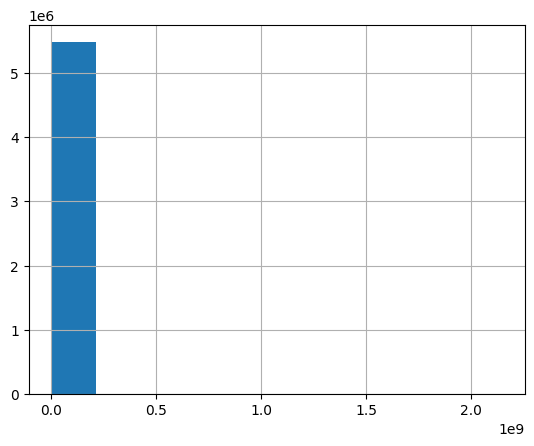

In [57]:
data['price'].hist()

In [58]:
data = data[(data['price'] >= 1150000.00) & (data['price'] <= 11396000.00)]

<Axes: >

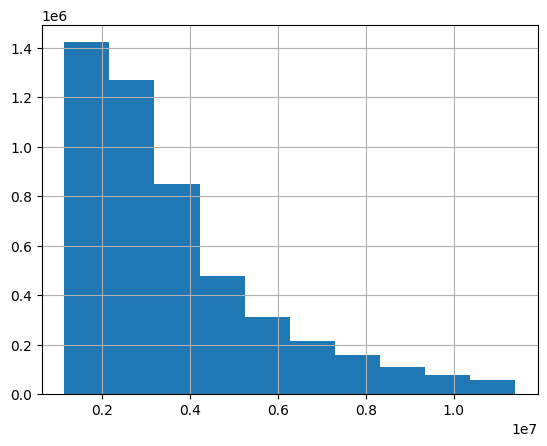

In [59]:
data['price'].hist()

<Axes: >

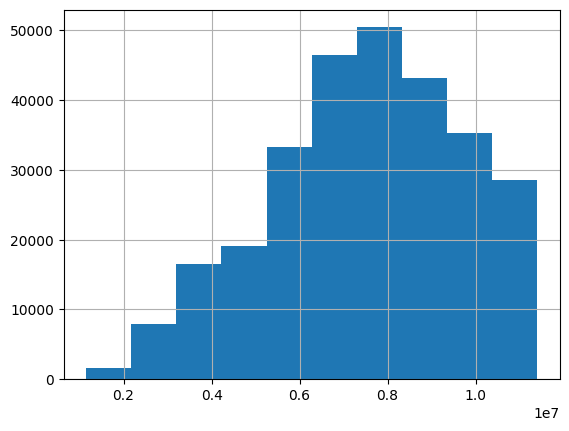

In [60]:
data[data['moscow'] == 'moscow']['price'].hist()

Построим более красивые графики с помощью библиотеки [plotly](https://plotly.com/)



In [61]:
import plotly.express as px

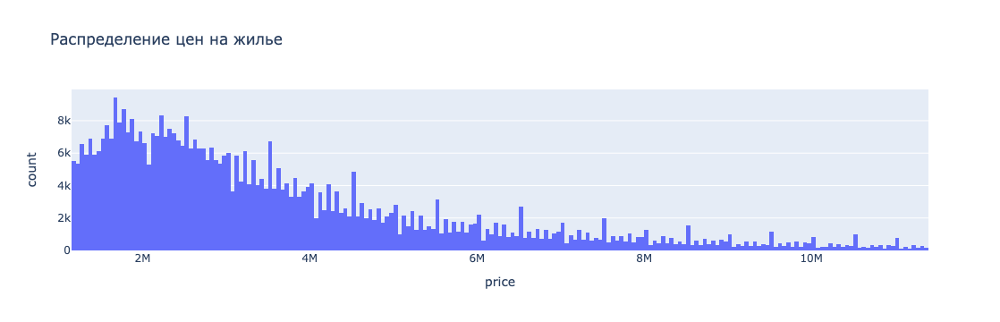

In [62]:
fig = px.histogram(data.sample(500_000), x='price',
                   title='Распределение цен на жилье')
fig.show()

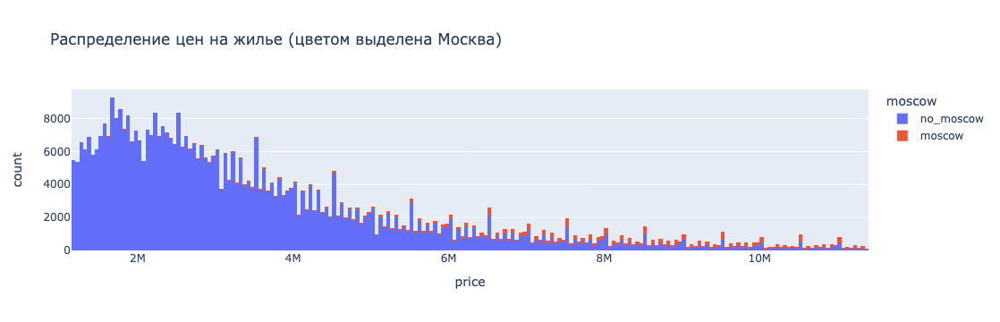

In [63]:
fig = px.histogram(data.sample(500_000), x='price', color='moscow',
                   title='Распределение цен на жилье (цветом выделена Москва)')
fig.show()

**<font color='orange'>(?) Вопрос:</font>** Какой вывод можем сделать по этому графику?

Добавим интерактива в графики, дополнительно установив библиотеку `dash`

In [64]:
# !pip install dash

In [65]:
from dash import Dash, dcc, html, Input, Output
import plotly.express as px

app = Dash(__name__)


app.layout = html.Div([
    html.H4('Распределение цен на жилье по годам'),
    dcc.Dropdown(
        id='dropdown',
        options=['2018', '2019', '2020', '2021'],
        value='2018',
        clearable=False,
    ),
    dcc.Graph(id='graph'),
])



@app.callback(
    Output('graph', 'figure'),
    Input('dropdown', 'value'))
def update_bar_chart(year):
    data_for_year = data.sample(100_000)
    mask = data_for_year['year'].astype(str) == year
    fig = px.histogram(data_for_year[mask], x='price', color='moscow')
    return fig

app.run_server(debug=True)

**<font color='orange'>(?) Вопрос:</font>** Какие выводы можем сделать по этому графику?

### Анализ `region`

Посмотрим на уникальные значения по этому полю

In [66]:
data['region'].unique()

array([ 2661,    81,  2871,  2843,     3,  3106,  2922,  2900,  2722,
        3230,  4417,  5282,  5368,  3446,  5520,  6817,  6171,  9579,
        2604,  1010,  9648,  7793, 13919,  3019,  4982,  5241,  3870,
        3991,  2359,  9654,  2072,  8090,  4007, 11171, 10160,  2860,
        7873,  2594,  8509, 11416, 11991,  5178, 13913,  6309,  5952,
        6543,  2880,  5993,  2484,  4240, 14880,  5789,  5794,  2528,
        2885,  4695,  2328,  5143,  6937,  2806, 14368,  5736,  7121,
        4086,   821, 10582,  7896,  8640,  5703, 10201,  4249,  4374,
        3153,  4189,  2814,  1491, 13098,  8894,  7929, 16705,    69,
        4963,  1901, 61888])

In [67]:
data['region'].value_counts()

region
9654     980972
2843     602618
81       485077
2661     390633
3        282513
          ...  
16705       118
69           66
4963         54
1901          9
61888         5
Name: count, Length: 84, dtype: int64

In [68]:
data['region'] = data['region'].astype(str)    # Так как значения region категориальные, преобразуем их в str

Пользуясь простейшим способом поиска названия регионов по координатам ('`geo_lat`', '`geo_lon`'), можно выписать все значения в словарь 'region_name' в соответствии с номером региона ('`region`') в датасете.

In [69]:
region_name = {
    '2661': 'Санкт-Петербург',
    '3446': 'Ленинградская область',
    '3': 'Москва',
    '81': 'Московская область',
    '2843': 'Краснодарский край',
    '2871': 'Нижегородская область',
    '3230': 'Ростовская область',
    '3106': 'Самарская область',
    '2922': 'Республика Татарстан',
    '2900': 'Ставропольский край',
    '2722': 'Республика Башкортостан',
    '6171': 'Свердловская область',
    '4417': 'Республика Коми',
    '5282': 'Челябинская область',
    '5368': 'Иркутская область',
    '5520': 'Пермский край',
    '6817': 'Алтайский край',
    '9579': 'Республика Бурятия',
    '2604': 'Ярославская область',
    '1010': 'Удмуртская Республика',
    '7793': 'Псковская область',
    '13919': 'Республика Северная Осетия — Алания',
    '2860': 'Кемеровская область',
    '3019': 'Чувашская Республика',
    '4982': 'Республика Марий Эл',
    '9648': 'Кабардино-Балкарская Республика',
    '5241': 'Республика Мордовия',
    '3870': 'Красноярский край',
    '3991': 'Тюменская область',
    '2359': 'Республика Хакасия',
    '9654': 'Новосибирская область',
    '2072': 'Воронежская область',
    '8090': 'Республика Карелия',
    '4007': 'Республика Дагестан',
    '11171': 'Республика Саха (Якутия)',
    '10160': 'Забайкальский край',
    '7873, 6937': 'Республика Крым',
    '2594': 'Кировская область',
    '8509': 'Республика Калмыкия',
    '11416': 'Республика Адыгея',
    '11991': 'Карачаево-Черкесская Республика',
    '5178': 'Республика Тыва',
    '13913': 'Республика Ингушетия',
    '6309': 'Республика Алтай',
    '5952': 'Белгородская область',
    '6543': 'Архангельская область',
    '2880': 'Тверская область',
    '5993': 'Пензенская область',
    '2484': 'Ханты-Мансийский автономный округ',
    '4240': 'Липецкая область',
    '5789': 'Владимирская область',
    '14880': 'Ямало-Ненецкий автономный округ',
    '1491': 'Рязанская область',
    '2885': 'Чеченская Республика',
    '5794': 'Смоленская область',
    '2528': 'Саратовская область',
    '4374': 'Вологодская область',
    '4695': 'Волгоградская область',
    '2328': 'Калужская область',
    '5143': 'Тульская область',
    '2806': 'Тамбовская область',
    '14368': 'Мурманская область',
    '5736': 'Новгородская область',
    '7121': 'Курская область',
    '4086': 'Хабаровский край',
    '821': 'Брянская область',
    '10582': 'Астраханская область',
    '7896': 'Калининградская область',
    '8640': 'Омская область',
    '5703': 'Курганская область',
    '10201': 'Томская область',
    '4249': 'Ульяновская область',
    '3153': 'Оренбургская область',
    '4189': 'Костромская область',
    '2814': 'Орловская область',
    '13098': 'Камчатский край',
    '8894': 'Ивановская область',
    '7929': 'Амурская область',
    '16705': 'Магаданская область',
    '69': 'Еврейская автономная область',
    '4963': 'Приморский край',
    '1901': 'Сахалинская область',
    '61888': 'Ненецкий автономный округ'
}

In [70]:
# Создаем новый столбец в нашем датасете, значения которого вытягивают названия из словаря 'region_name'
data['region_name'] = data['region'].map(region_name)

In [71]:
data.head(5)

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,...,kitchen_area,object_type,price_per_1m,high_level,live_area,avg_live_area,is_room_bigger,moscow,year,region_name
0,6050000.00,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,...,10.80,1,73244.55,high_level,71.80,23.93,True,no_moscow,2018,Санкт-Петербург
1,8650000.00,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,...,12.00,1,125180.90,low_level,57.10,28.55,True,no_moscow,2018,Московская область
2,4000000.00,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,...,10.00,1,60606.06,high_level,56.00,18.67,True,no_moscow,2018,Нижегородская область
3,1850000.00,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,...,5.00,11,48684.21,high_level,33.00,16.50,True,no_moscow,2018,Краснодарский край
4,5450000.00,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,...,10.00,1,90833.33,high_level,50.00,25.00,True,no_moscow,2018,Московская область


In [72]:
df_region = data['region_name'].value_counts(ascending=False)

In [73]:
df_region

region_name
Новосибирская область           980972
Краснодарский край              602618
Московская область              485077
Санкт-Петербург                 390633
Москва                          282513
                                 ...  
Магаданская область                118
Еврейская автономная область        66
Приморский край                     54
Сахалинская область                  9
Ненецкий автономный округ            5
Name: count, Length: 82, dtype: int64

In [74]:
df_region.index

Index(['Новосибирская область', 'Краснодарский край', 'Московская область',
       'Санкт-Петербург', 'Москва', 'Республика Татарстан',
       'Свердловская область', 'Ростовская область', 'Тюменская область',
       'Челябинская область', 'Ярославская область', 'Нижегородская область',
       'Республика Башкортостан', 'Красноярский край', 'Самарская область',
       'Алтайский край', 'Воронежская область', 'Ставропольский край',
       'Чувашская Республика', 'Ленинградская область', 'Белгородская область',
       'Пермский край', 'Удмуртская Республика', 'Калининградская область',
       'Республика Дагестан', 'Республика Марий Эл', 'Иркутская область',
       'Кемеровская область', 'Забайкальский край', 'Республика Коми',
       'Республика Мордовия', 'Республика Хакасия', 'Республика Карелия',
       'Кабардино-Балкарская Республика', 'Тверская область',
       'Республика Саха (Якутия)', 'Республика Северная Осетия — Алания',
       'Республика Бурятия', 'Владимирская область', '

In [75]:
df_region = pd.DataFrame({'region_name': df_region.index,
                          'counts': df_region})
df_region

,region_name,counts
region_name,,
Новосибирская область,Новосибирская область,980972
Краснодарский край,Краснодарский край,602618
Московская область,Московская область,485077
Санкт-Петербург,Санкт-Петербург,390633
Москва,Москва,282513
...,...,...
Магаданская область,Магаданская область,118
Еврейская автономная область,Еврейская автономная область,66
Приморский край,Приморский край,54


In [76]:
df_region = df_region.reset_index(drop=True)
df_region

,region_name,counts
0,Новосибирская область,980972
1,Краснодарский край,602618
2,Московская область,485077
3,Санкт-Петербург,390633
4,Москва,282513
...,...,...
77,Магаданская область,118
78,Еврейская автономная область,66
79,Приморский край,54
80,Сахалинская область,9


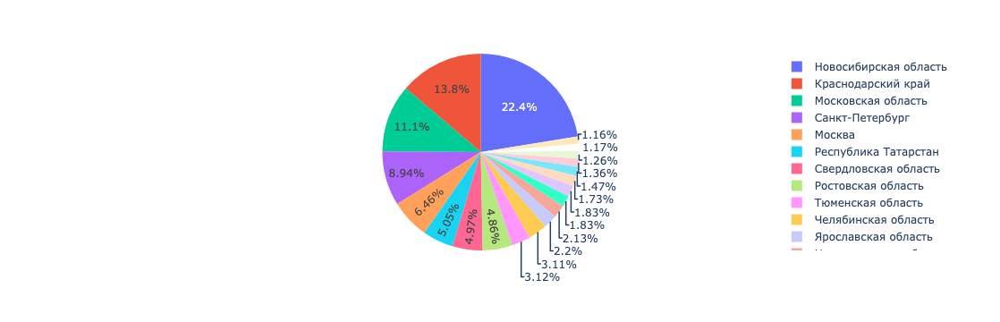

In [77]:
fig = px.pie(df_region.head(20), values='counts', names='region_name')
fig.show()

Также для разведочного анализа может помочь метод `groupby(column)`.

Он группирует объекты по указанной(-ым) колонке(-ам). Необходимо также указать какую статистику для группировки выводить. Посмотрим, как можно легко посчитать среднюю цену на жилью в разрезе по регионам

In [78]:
data[['region_name','price']].groupby('region_name')['price'].mean()

region_name
Алтайский край                    2396220.87
Амурская область                  4631853.29
Архангельская область             3834542.70
Астраханская область              3098467.04
Белгородская область              3302548.50
                                     ...    
Челябинская область               2175001.51
Чеченская Республика              2808831.78
Чувашская Республика              2450307.90
Ямало-Ненецкий автономный округ   4071345.26
Ярославская область               2645544.68
Name: price, Length: 82, dtype: float64

In [79]:
data[['region_name','price']].groupby('region_name')['price'].agg(['mean', 'max', 'min'])

,mean,max,min
region_name,,,
Алтайский край,2396220.87,11300000.00,1150000.00
Амурская область,4631853.29,11000000.00,1150000.00
Архангельская область,3834542.70,11300000.00,1150000.00
Астраханская область,3098467.04,10950000.00,1150000.00
Белгородская область,3302548.50,11300000.00,1150000.00
...,...,...,...
Челябинская область,2175001.51,11370000.00,1150000.00
Чеченская Республика,2808831.78,11000000.00,1150000.00
Чувашская Республика,2450307.90,11299999.00,1150000.00


In [80]:
data[['region_name','price', 'year']].groupby(['year','region_name'])['price'].agg(['mean', 'max', 'min'])

mean         max        min
year region_name                                                      
2018 Алтайский край                  2284563.64 11200000.00 1150000.00
     Амурская область                3031158.97  8000000.00 1250000.00
     Архангельская область           3123987.54 10600000.00 1160000.00
     Астраханская область            2393439.84  9500000.00 1150000.00
     Белгородская область            2619083.40  8200000.00 1150000.00
...                                         ...         ...        ...
2021 Челябинская область             2496077.56 11000000.00 1150000.00
     Чеченская Республика            3384487.58 11000000.00 1200000.00
     Чувашская Республика            2923143.80 11200000.00 1150000.00
     Ямало-Ненецкий автономный округ 5552062.50 11200000.00 1200000.00
     Ярославская область             3206259.86 11300000.00 1150000.00

[322 rows x 3 columns]

In [81]:
df_region2 = data[['region_name','price']].groupby('region_name')['price'].agg(['mean', 'max', 'min', 'count'])
df_region2 = df_region2.reset_index() # Обратите внимание, здесь индексы не удаляем
df_region2

,region_name,mean,max,min,count
0,Алтайский край,2396220.87,11300000.00,1150000.00,64186
1,Амурская область,4631853.29,11000000.00,1150000.00,2110
2,Архангельская область,3834542.70,11300000.00,1150000.00,3828
3,Астраханская область,3098467.04,10950000.00,1150000.00,1628
4,Белгородская область,3302548.50,11300000.00,1150000.00,47056
...,...,...,...,...,...
77,Челябинская область,2175001.51,11370000.00,1150000.00,136089
78,Чеченская Республика,2808831.78,11000000.00,1150000.00,2252
79,Чувашская Республика,2450307.90,11299999.00,1150000.00,51276
80,Ямало-Ненецкий автономный округ,4071345.26,11200000.00,1150000.00,336


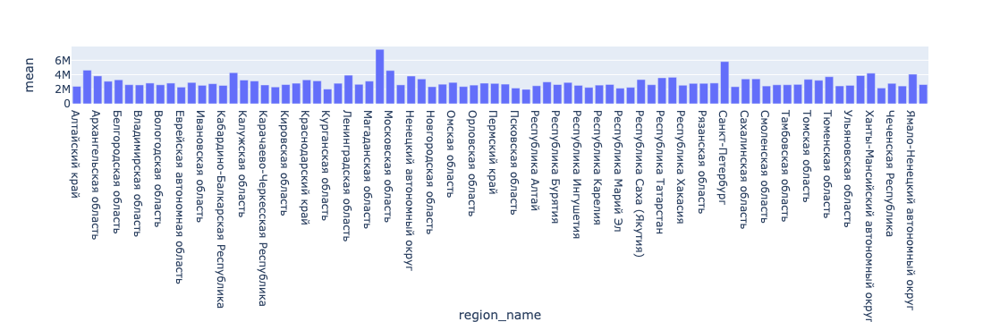

In [82]:
fig = px.bar(df_region2, x='region_name', y='mean')
fig.show()

Если вы знакомы с SQL, то знаете, что очень используется операция `JOIN` для соединения нескольких таблиц по тому или иному значению. В pandas для этого используется `merge`.



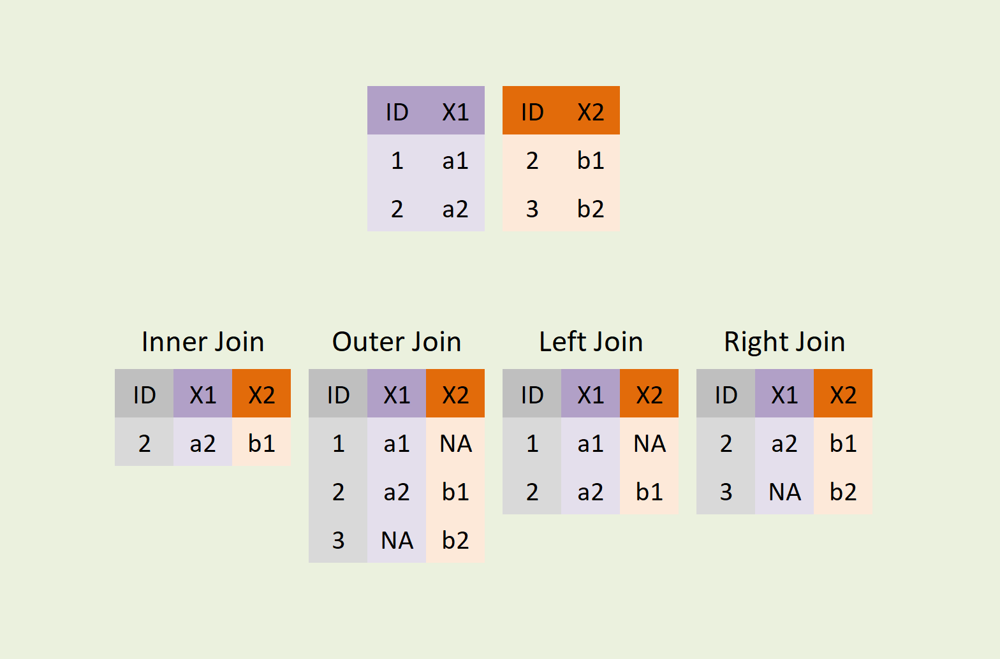

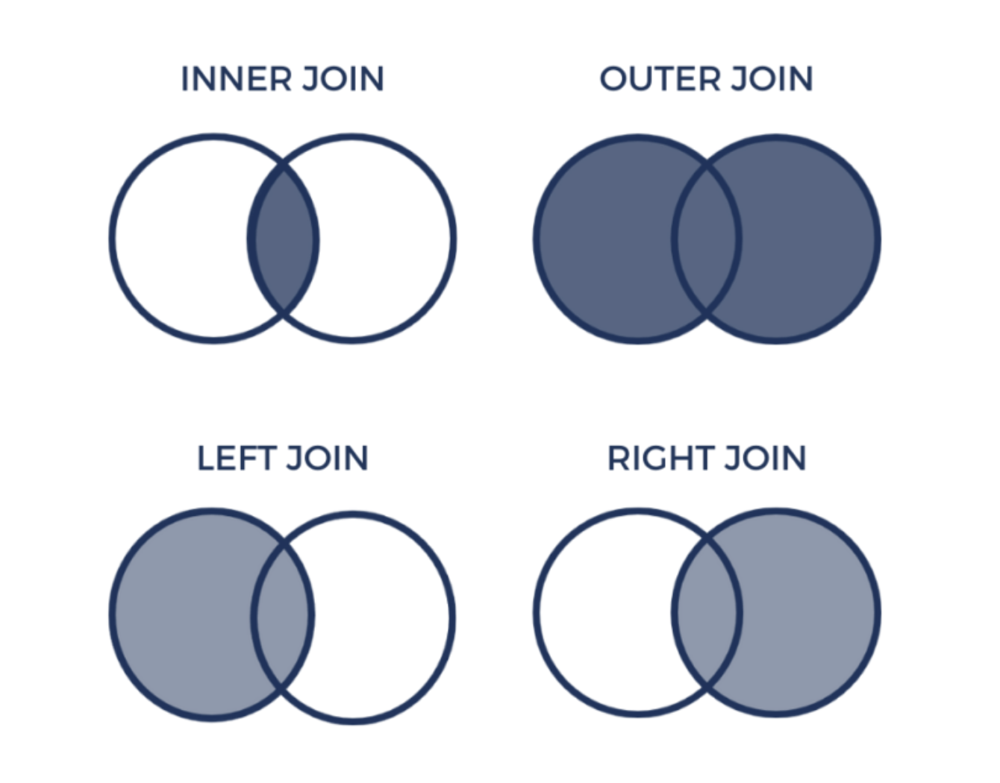

У нас есть две таблицы:

1.   Общая таблица по ценам на квартиры
2.   Агрегированная таблица со средней ценой на квартиру в разрезе по регионам

Допустим, мы хотим создать признак, который будет отображать выше или ниже цена на конкретную квартиру, чем средняя цена по региону.
Для этого нам потребуется операция `merge` по столбцу `region_name`:

In [83]:
data = data.merge(df_region2, on='region_name', how='left')
data.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,...,live_area,avg_live_area,is_room_bigger,moscow,year,region_name,mean,max,min,count
0,6050000.00,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,...,71.80,23.93,True,no_moscow,2018,Санкт-Петербург,5815801.04,11396000.00,1150000.00,390633.00
1,8650000.00,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,...,57.10,28.55,True,no_moscow,2018,Московская область,4584447.01,11396000.00,1150000.00,485077.00
2,4000000.00,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,...,56.00,18.67,True,no_moscow,2018,Нижегородская область,3417017.54,11396000.00,1150000.00,93272.00
3,1850000.00,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,...,33.00,16.50,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00
4,5450000.00,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,...,50.00,25.00,True,no_moscow,2018,Московская область,4584447.01,11396000.00,1150000.00,485077.00


### **<font color='orange'>[Задание 5]</font>**

Создайте новый признак, который будет отражать сравнение цены конкретной квартиры со средней ценой по региону

In [84]:
# ваш код

## 5. Еще графики

График зависимости цены от площади

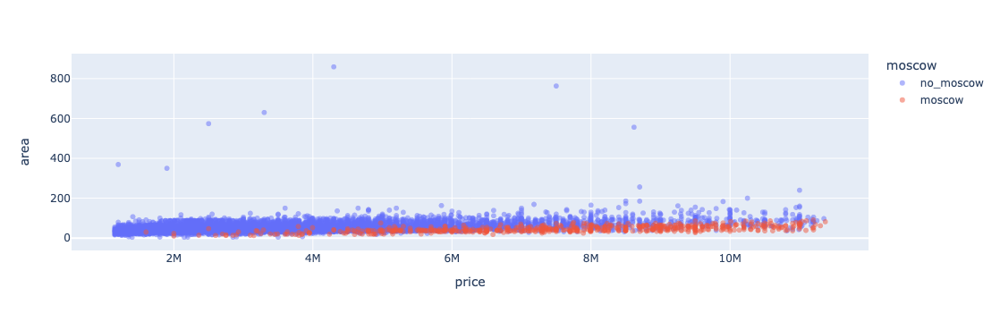

In [85]:
fig = px.scatter(data.sample(10_000), x='price', y='area', color='moscow', opacity=0.5)
fig.show()

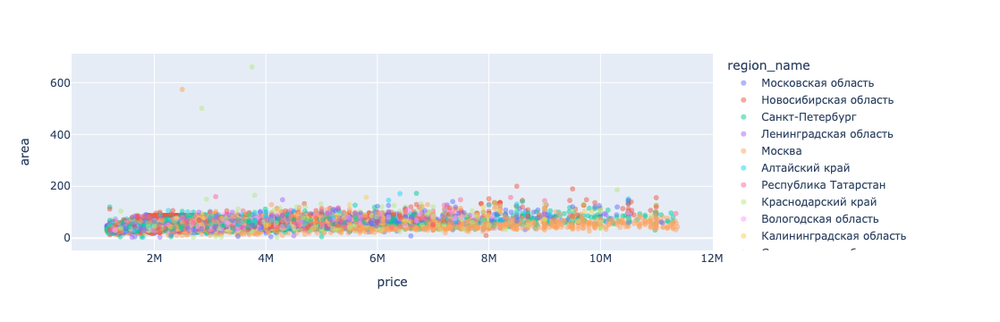

In [86]:
fig = px.scatter(data.sample(10_000), x='price', y='area', color='region_name', opacity=0.5)
fig.show()

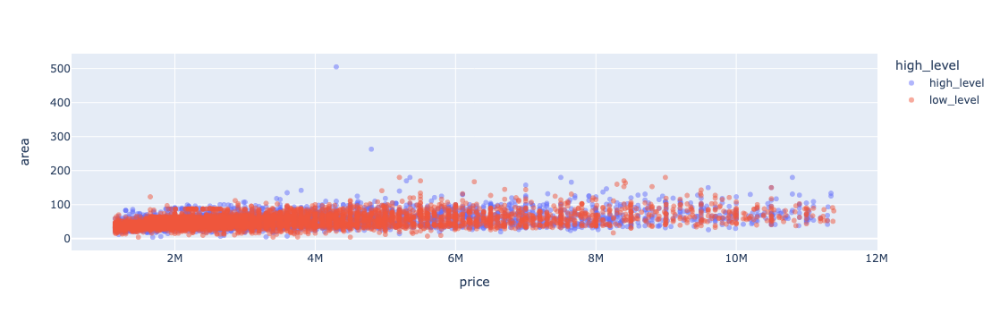

In [87]:
fig = px.scatter(data.sample(10_000), x='price', y='area', color='high_level', opacity=0.5)
fig.show()

А что, если зависимость другая - 1й этаж, последний этаж?

In [88]:
# 1 этаж, последний этаж, середина
data['first_last_level'] = data.apply(lambda x: 'first_level' if x['level'] == 1 else 'last_level' if x['level'] == x['levels'] else 'other', axis=1)
data.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,...,avg_live_area,is_room_bigger,moscow,year,region_name,mean,max,min,count,first_last_level
0,6050000.00,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,...,23.93,True,no_moscow,2018,Санкт-Петербург,5815801.04,11396000.00,1150000.00,390633.00,other
1,8650000.00,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,...,28.55,True,no_moscow,2018,Московская область,4584447.01,11396000.00,1150000.00,485077.00,other
2,4000000.00,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,...,18.67,True,no_moscow,2018,Нижегородская область,3417017.54,11396000.00,1150000.00,93272.00,other
3,1850000.00,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,...,16.50,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
4,5450000.00,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,...,25.00,True,no_moscow,2018,Московская область,4584447.01,11396000.00,1150000.00,485077.00,other


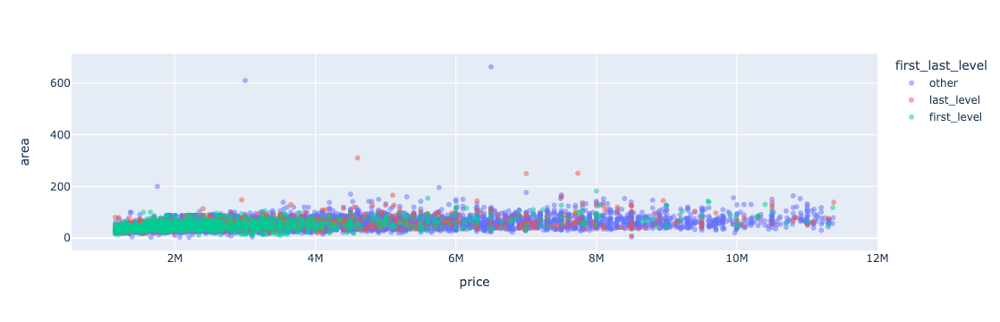

In [89]:
fig = px.scatter(data.sample(10_000), x='price', y='area', color='first_last_level', opacity=0.5)
fig.show()

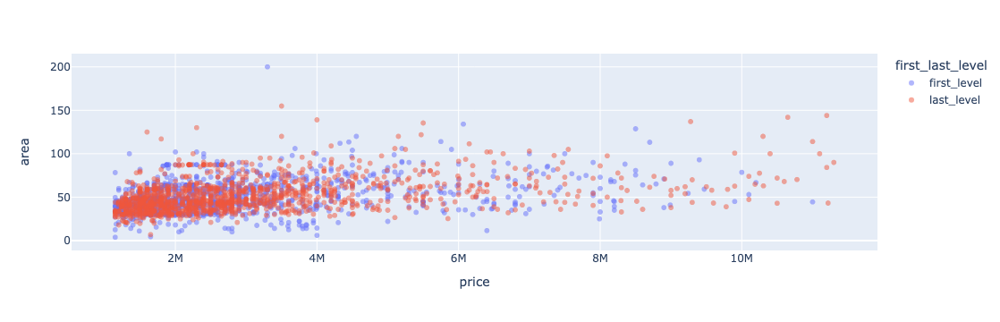

In [90]:
d = data.sample(10_000)
d = d[d['first_last_level'] != 'other']
fig = px.scatter(d, x='price', y='area', color='first_last_level', opacity=0.5)
fig.show()

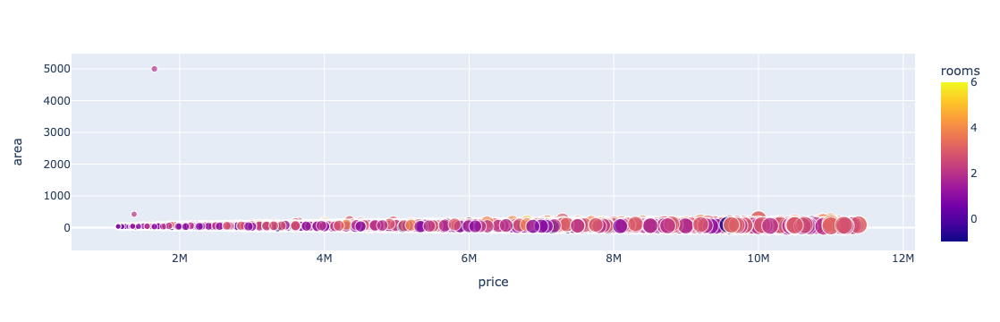

In [91]:
fig = px.scatter(data.sample(10_000), x='price', y='area', color='rooms',
                 size='price', hover_data=['region_name'])
fig.show()

In [92]:
data['object_type'] = data['object_type'].astype(str)
data['building_type'] = data['building_type'].astype(str)

**<font color='orange'>(?) Вопрос:</font>** Почему мы меняем тип данных в колонках?

**box plot** - вид диаграммы, показывающий в удобной форме  медиану (или, если нужно, среднее), нижний и верхний квартили, минимальное и максимальное значение выборки и выбросы.

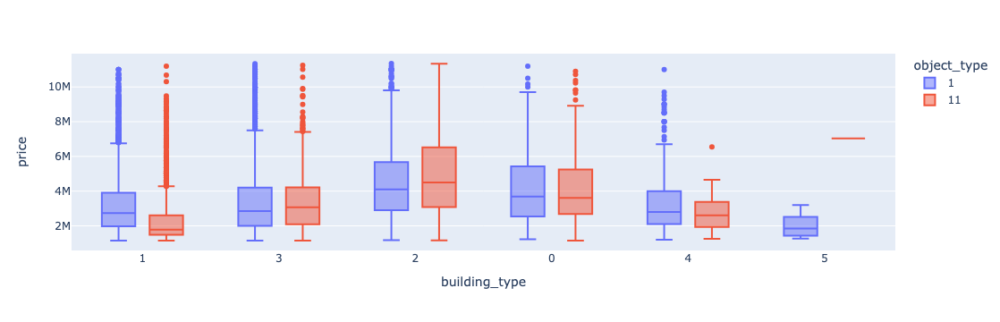

In [93]:
fig = px.box(data.sample(10_000), y='price', x='building_type', color='object_type')
fig.show()

Еще больше графиков:

In [94]:
d = data.sample(1000)

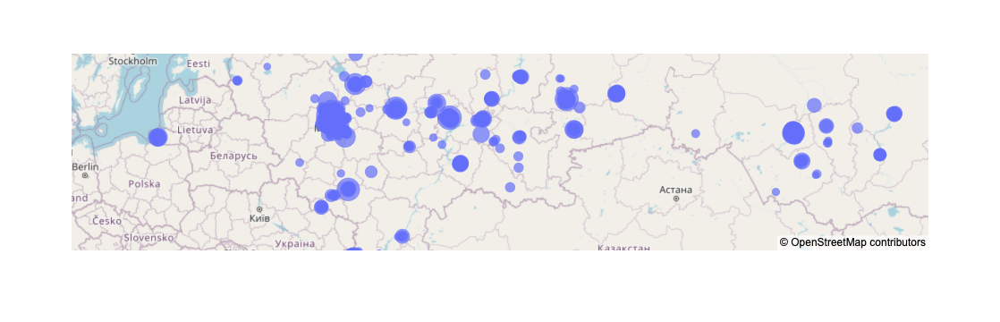

In [95]:
fig = px.scatter_mapbox(d,
                        lat='geo_lat',
                        lon='geo_lon',
                        hover_name='region_name',
                        size='price',
                        zoom=3)
fig.update_layout(mapbox_style="open-street-map")
fig.show()

## Вывод

Итак, мы разобрали базовые принципы работы с данными. Для каждой задачи машинного обучения - исследование данных и разведочный анализ являются первым этапом.

Почему так важно исследовать данные?
Бывает так, что некоторые задачи [можно вовсе решить без ML](https://alexanderdyakonov.wordpress.com/2018/06/28/%D0%BF%D1%80%D0%BE%D1%81%D1%82%D1%8B%D0%B5-%D0%BC%D0%B5%D1%82%D0%BE%D0%B4%D1%8B-%D0%B0%D0%BD%D0%B0%D0%BB%D0%B8%D0%B7%D0%B0-%D0%B4%D0%B0%D0%BD%D0%BD%D1%8B%D1%85/), а некоторые, наоборот, невозможно решить с помощью ML только потому что исходнные данные "грязные". Например, в нашем примере была отрицательная стоимость квартиры.

Поэтому `pandas` и `plotly` - теперь ваши напарники в каждой задаче!


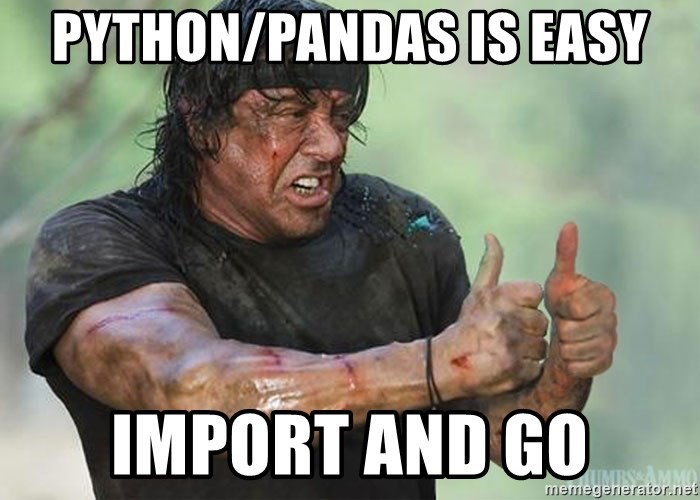

In [96]:
data

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,...,avg_live_area,is_room_bigger,moscow,year,region_name,mean,max,min,count,first_last_level
0,6050000.00,2018-02-19,20:00:21,59.81,30.38,2661,1,8,10,3,...,23.93,True,no_moscow,2018,Санкт-Петербург,5815801.04,11396000.00,1150000.00,390633.00,other
1,8650000.00,2018-02-27,12:04:54,55.68,37.30,81,3,5,24,2,...,28.55,True,no_moscow,2018,Московская область,4584447.01,11396000.00,1150000.00,485077.00,other
2,4000000.00,2018-02-28,15:44:00,56.30,44.06,2871,1,5,9,3,...,18.67,True,no_moscow,2018,Нижегородская область,3417017.54,11396000.00,1150000.00,93272.00,other
3,1850000.00,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,...,16.50,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
4,5450000.00,2018-03-01,17:42:43,55.92,37.98,81,3,13,14,2,...,25.00,True,no_moscow,2018,Московская область,4584447.01,11396000.00,1150000.00,485077.00,other
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4950605,6400000.00,2021-05-01,20:13:41,55.90,37.98,81,3,4,17,3,...,23.80,True,no_moscow,2021,Московская область,4584447.01,11396000.00,1150000.00,485077.00,other
4950606,7200000.00,2021-05-01,20:13:42,59.77,30.06,3446,2,2,3,2,...,18.35,False,no_moscow,2021,Ленинградская область,3935724.72,11390000.00,1150000.00,50604.00,other
4950607,4900000.00,2021-05-01,20:13:43,59.85,30.36,2661,1,2,5,1,...,25.00,True,no_moscow,2021,Санкт-Петербург,5815801.04,11396000.00,1150000.00,390633.00,other
4950608,9000000.00,2021-05-01,20:13:48,44.05,42.87,2900,3,4,5,4,...,39.50,True,no_moscow,2021,Ставропольский край,2613888.28,11300000.00,1150000.00,55039.00,other


In [97]:
# data.mean()

In [104]:
data[data['region_name'] == "Краснодарский край"]

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,...,avg_live_area,is_room_bigger,moscow,year,region_name,mean,max,min,count,first_last_level
3,1850000.00,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,...,16.50,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
19,1650000.00,2018-03-16,16:21:54,44.99,41.12,2843,3,5,5,2,...,22.00,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,last_level
30,2500000.00,2018-04-04,19:37:22,43.63,39.73,2843,2,2,8,-1,...,-20.00,False,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
43,2600000.00,2018-04-23,09:53:29,45.00,39.08,2843,4,3,5,2,...,19.00,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
47,2220000.00,2018-04-25,09:22:20,45.00,39.08,2843,3,2,18,1,...,33.10,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4950527,4050000.00,2021-05-01,19:51:43,44.72,37.76,2843,2,18,22,1,...,26.00,True,no_moscow,2021,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
4950560,7500000.00,2021-05-01,20:00:43,44.90,37.32,2843,2,16,17,1,...,30.00,True,no_moscow,2021,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
4950568,2700000.00,2021-05-01,20:03:41,45.10,39.03,2843,2,8,17,1,...,24.00,True,no_moscow,2021,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
4950600,5800000.00,2021-05-01,20:12:44,45.09,39.04,2843,2,1,16,2,...,24.50,True,no_moscow,2021,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,first_level


In [108]:
data_k = data[data['region_name'] == "Краснодарский край"]

In [109]:
data_k.head()

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,...,avg_live_area,is_room_bigger,moscow,year,region_name,mean,max,min,count,first_last_level
3,1850000.00,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,...,16.50,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
19,1650000.00,2018-03-16,16:21:54,44.99,41.12,2843,3,5,5,2,...,22.00,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,last_level
30,2500000.00,2018-04-04,19:37:22,43.63,39.73,2843,2,2,8,-1,...,-20.00,False,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
43,2600000.00,2018-04-23,09:53:29,45.00,39.08,2843,4,3,5,2,...,19.00,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
47,2220000.00,2018-04-25,09:22:20,45.00,39.08,2843,3,2,18,1,...,33.10,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other


<Axes: >

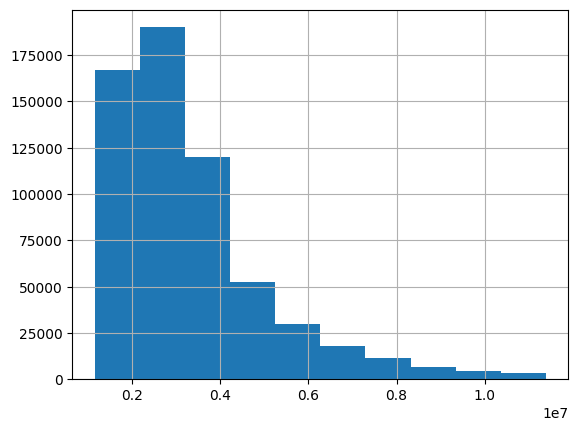

In [110]:
data_k['price'].hist()

In [111]:
data_k.describe()

,price,date,geo_lat,geo_lon,level,levels,rooms,area,kitchen_area,price_per_1m,live_area,avg_live_area,year,mean,max,min,count
count,602618.00,602618,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00
mean,3293149.79,2019-10-27 17:38:10.776578304,44.88,38.89,6.33,11.46,1.63,52.39,11.61,65480.49,40.77,23.40,2019.31,3293149.79,11389451.00,1150000.00,602618.00
min,1150000.00,2018-03-01 00:00:00,43.39,36.65,1.00,1.00,-2.00,0.48,0.04,320.00,-8184.00,-4092.00,2018.00,3293149.79,11389451.00,1150000.00,602618.00
25%,2100000.00,2019-03-06 00:00:00,44.89,38.93,3.00,5.00,1.00,38.00,9.00,47894.74,27.70,20.33,2019.00,3293149.79,11389451.00,1150000.00,602618.00
50%,2800000.00,2019-10-14 00:00:00,45.04,39.01,5.00,10.00,2.00,47.00,11.00,58260.87,35.60,25.00,2019.00,3293149.79,11389451.00,1150000.00,602618.00
75%,3950000.00,2020-05-21 00:00:00,45.07,39.04,9.00,16.00,2.00,62.60,14.00,73076.92,50.20,28.90,2020.00,3293149.79,11389451.00,1150000.00,602618.00
max,11389451.00,2021-05-01 00:00:00,46.85,41.58,36.00,38.00,9.00,7625.00,8235.00,5104166.67,7602.80,4284.00,2021.00,3293149.79,11389451.00,1150000.00,602618.00
std,1741892.94,NaN,0.50,0.66,4.82,6.48,0.95,28.62,12.39,40383.18,28.98,18.82,0.83,0.00,0.00,0.00,0.00


In [112]:
data.describe()

,price,date,geo_lat,geo_lon,level,levels,rooms,area,kitchen_area,price_per_1m,live_area,avg_live_area,year,mean,max,min,count
count,4950610.00,4950610,4950610.00,4950610.00,4950610.00,4950610.00,4950610.00,4950610.00,4950610.00,4950610.00,4950610.00,4950610.00,4950610.00,4944113.00,4944113.00,4944113.00,4944113.00
mean,3615450.43,2019-11-19 10:15:37.085974784,53.92,53.68,6.22,11.45,1.70,52.38,10.44,72942.00,41.93,21.46,2019.37,3614108.70,11347630.32,1150003.28,412229.87
min,1150000.00,2018-02-19 00:00:00,41.46,19.89,1.00,1.00,-2.00,0.07,0.01,239.19,-9962.00,-9962.00,2018.00,1989129.84,5500000.00,1150000.00,5.00
25%,2020000.00,2019-03-15 00:00:00,53.33,37.91,3.00,5.00,1.00,38.60,7.00,44370.86,28.20,19.00,2019.00,2692689.90,11370000.00,1150000.00,95961.00
50%,2980000.00,2019-10-11 00:00:00,55.11,43.88,5.00,10.00,2.00,48.00,9.70,60833.33,38.00,23.40,2019.00,3293149.79,11390000.00,1150000.00,282513.00
75%,4500000.00,2020-07-15 00:00:00,56.18,82.76,9.00,16.00,2.00,62.00,12.30,86764.71,51.30,27.50,2020.00,3935724.72,11396000.00,1150000.00,602618.00
max,11396000.00,2021-05-01 00:00:00,71.98,162.54,39.00,39.00,9.00,7856.00,9999.00,30142857.14,7846.00,5705.60,2021.00,7494770.61,11396000.00,1400000.00,980972.00
std,2146199.92,NaN,4.65,20.81,4.89,6.40,1.05,27.87,9.23,49811.63,27.31,19.52,0.87,1341956.32,185121.13,577.68,336299.54


In [113]:
data_k

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,...,avg_live_area,is_room_bigger,moscow,year,region_name,mean,max,min,count,first_last_level
3,1850000.00,2018-03-01,11:24:52,45.00,39.07,2843,4,12,16,2,...,16.50,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
19,1650000.00,2018-03-16,16:21:54,44.99,41.12,2843,3,5,5,2,...,22.00,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,last_level
30,2500000.00,2018-04-04,19:37:22,43.63,39.73,2843,2,2,8,-1,...,-20.00,False,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
43,2600000.00,2018-04-23,09:53:29,45.00,39.08,2843,4,3,5,2,...,19.00,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
47,2220000.00,2018-04-25,09:22:20,45.00,39.08,2843,3,2,18,1,...,33.10,True,no_moscow,2018,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4950527,4050000.00,2021-05-01,19:51:43,44.72,37.76,2843,2,18,22,1,...,26.00,True,no_moscow,2021,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
4950560,7500000.00,2021-05-01,20:00:43,44.90,37.32,2843,2,16,17,1,...,30.00,True,no_moscow,2021,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
4950568,2700000.00,2021-05-01,20:03:41,45.10,39.03,2843,2,8,17,1,...,24.00,True,no_moscow,2021,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
4950600,5800000.00,2021-05-01,20:12:44,45.09,39.04,2843,2,1,16,2,...,24.50,True,no_moscow,2021,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,first_level


In [122]:
data['price'].mean(), data_k['price'].mean()

(3615450.427910702, 3293149.7908542394)

In [125]:
data[data['moscow'] == 'no_moscow']['price'].mean(), data_k['price'].mean()

(3380674.161947363, 3293149.7908542394)

In [123]:
data['price_per_1m'].mean(), data_k['price_per_1m'].mean()

(72941.99750045699, 65480.486552485774)

In [124]:
data[data['moscow'] == 'no_moscow']['price_per_1m'].mean(), data_k['price_per_1m'].mean()

(66637.16845718941, 65480.486552485774)

In [114]:
data['year'].value_counts(), data_k['year'].value_counts()

(year
 2019    2031884
 2020    1632355
 2018     784682
 2021     501689
 Name: count, dtype: int64,
 year
 2019    262509
 2020    195037
 2018     98779
 2021     46293
 Name: count, dtype: int64)

In [116]:
data['rooms'].value_counts(), data_k['rooms'].value_counts()

(rooms
  1    1897912
  2    1693861
  3     961081
 -1     270158
  4     115612
  5      10822
  6        654
  7        196
  9        134
 -2        112
  8         68
 Name: count, dtype: int64,
 rooms
  1    271160
  2    204544
  3     93305
 -1     23245
  4      9019
  5      1169
  6       104
  7        30
  9        20
 -2        13
  8         9
 Name: count, dtype: int64)

In [117]:
data['first_last_level'].value_counts(), data_k['first_last_level'].value_counts()

(first_last_level
 other          3731027
 last_level      619991
 first_level     599592
 Name: count, dtype: int64,
 first_last_level
 other          464690
 last_level      72461
 first_level     65467
 Name: count, dtype: int64)

In [118]:
data['live_area'].mean(), data_k['live_area'].mean()

(41.93299789520892, 40.77229998108254)

In [120]:
data['levels'].mean(), data_k['levels'].mean()

(11.446363377442376, 11.464192904958033)

In [121]:
data['kitchen_area'].mean(), data_k['kitchen_area'].mean()

(10.442557555533554, 11.613780056354107)

In [119]:
data_k.columns

Index(['price', 'date', 'time', 'geo_lat', 'geo_lon', 'region',
       'building_type', 'level', 'levels', 'rooms', 'area', 'kitchen_area',
       'object_type', 'price_per_1m', 'high_level', 'live_area',
       'avg_live_area', 'is_room_bigger', 'moscow', 'year', 'region_name',
       'mean', 'max', 'min', 'count', 'first_last_level'],
      dtype='object')

In [140]:
from dash import Dash, dcc, html, Input, Output
import plotly.express as px

app = Dash(__name__)


app.layout = html.Div(
    [
    html.H4('Распределение цен на жилье по годам'),
    dcc.Dropdown(
        id='dropdown',
        options=['2018', '2019', '2020', '2021'],
        value='2018',
        clearable=False,
    ),
    ],
    [
    dcc.Dropdown(
        id='dropdown2',
        options=list(data_k.columns),
        value='price',
        clearable=False,
    ),
    dcc.Graph(id='graph'),
    ],
    
)



@app.callback(
    Output('graph', 'figure'),
    Input('dropdown', 'value'))
def update_bar_chart(year, feature):
    data_for_year = data_k
    mask = (data_for_year['year'].astype(str) == year)
    fig = px.histogram(data_for_year[mask], x=feature)
    return fig

app.run_server(debug=True)

TypeError: `id` prop must be a string or dict, not [Dropdown(options=['price', 'date', 'time', 'geo_lat', 'geo_lon', 'region', 'building_type', 'level', 'levels', 'rooms', 'area', 'kitchen_area', 'object_type', 'price_per_1m', 'high_level', 'live_area', 'avg_live_area', 'is_room_bigger', 'moscow', 'year', 'region_name', 'mean', 'max', 'min', 'count', 'first_last_level'], value='price', clearable=False, id='dropdown2'), Graph(id='graph')]

In [128]:
data_k.describe()

,price,date,geo_lat,geo_lon,level,levels,rooms,area,kitchen_area,price_per_1m,live_area,avg_live_area,year,mean,max,min,count
count,602618.00,602618,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00,602618.00
mean,3293149.79,2019-10-27 17:38:10.776578304,44.88,38.89,6.33,11.46,1.63,52.39,11.61,65480.49,40.77,23.40,2019.31,3293149.79,11389451.00,1150000.00,602618.00
min,1150000.00,2018-03-01 00:00:00,43.39,36.65,1.00,1.00,-2.00,0.48,0.04,320.00,-8184.00,-4092.00,2018.00,3293149.79,11389451.00,1150000.00,602618.00
25%,2100000.00,2019-03-06 00:00:00,44.89,38.93,3.00,5.00,1.00,38.00,9.00,47894.74,27.70,20.33,2019.00,3293149.79,11389451.00,1150000.00,602618.00
50%,2800000.00,2019-10-14 00:00:00,45.04,39.01,5.00,10.00,2.00,47.00,11.00,58260.87,35.60,25.00,2019.00,3293149.79,11389451.00,1150000.00,602618.00
75%,3950000.00,2020-05-21 00:00:00,45.07,39.04,9.00,16.00,2.00,62.60,14.00,73076.92,50.20,28.90,2020.00,3293149.79,11389451.00,1150000.00,602618.00
max,11389451.00,2021-05-01 00:00:00,46.85,41.58,36.00,38.00,9.00,7625.00,8235.00,5104166.67,7602.80,4284.00,2021.00,3293149.79,11389451.00,1150000.00,602618.00
std,1741892.94,NaN,0.50,0.66,4.82,6.48,0.95,28.62,12.39,40383.18,28.98,18.82,0.83,0.00,0.00,0.00,0.00


In [133]:
data_for_year = data_k
mask = (data_for_year['year'].astype(str) == "2020")

In [134]:
data_for_year[mask]

,price,date,time,geo_lat,geo_lon,region,building_type,level,levels,rooms,...,avg_live_area,is_room_bigger,moscow,year,region_name,mean,max,min,count,first_last_level
2816609,2774652.00,2020-01-01,02:04:29,45.02,39.05,2843,0,12,22,1,...,25.20,True,no_moscow,2020,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
2816617,1960000.00,2020-01-01,02:15:12,45.07,38.91,2843,0,15,16,1,...,27.00,True,no_moscow,2020,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
2816619,4800000.00,2020-01-01,02:22:38,45.07,38.97,2843,0,14,20,3,...,23.00,True,no_moscow,2020,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
2816620,1700000.00,2020-01-01,02:22:41,45.01,39.01,2843,0,12,17,1,...,25.50,True,no_moscow,2020,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
2816621,2050000.00,2020-01-01,02:22:44,45.15,39.00,2843,3,1,7,1,...,27.00,True,no_moscow,2020,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,first_level
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4448844,6660000.00,2020-12-30,22:28:46,43.58,39.75,2843,4,4,5,2,...,16.75,True,no_moscow,2020,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
4448853,3100000.00,2020-12-30,22:41:45,46.69,38.29,2843,3,4,5,3,...,18.10,True,no_moscow,2020,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
4448878,2300000.00,2020-12-30,23:12:40,43.47,39.93,2843,4,2,4,1,...,16.90,True,no_moscow,2020,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other
4448893,3650000.00,2020-12-30,23:33:42,45.07,39.04,2843,3,19,20,1,...,28.00,True,no_moscow,2020,Краснодарский край,3293149.79,11389451.00,1150000.00,602618.00,other


In [138]:
list(data_k.columns)

['price',
 'date',
 'time',
 'geo_lat',
 'geo_lon',
 'region',
 'building_type',
 'level',
 'levels',
 'rooms',
 'area',
 'kitchen_area',
 'object_type',
 'price_per_1m',
 'high_level',
 'live_area',
 'avg_live_area',
 'is_room_bigger',
 'moscow',
 'year',
 'region_name',
 'mean',
 'max',
 'min',
 'count',
 'first_last_level']